# Unit 5 - Financial Planning


In [15]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
from datetime import date, timedelta
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [2]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the `requests` Library

In [3]:
# Set current amount of crypto assets
# YOUR CODE HERE!
my_btc = 1.2
my_eth = 5.3

In [4]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [5]:
req = requests.get(eth_url)
req.json()['data']['1027']['quotes']['USD']['price']

366.96

In [6]:
# Fetch current BTC price
# YOUR CODE HERE!
btc_req = requests.get(btc_url)
btc_price = btc_req.json()['data']['1']['quotes']['USD']['price']

# Fetch current ETH price
# YOUR CODE HERE!]
eth_req = requests.get(eth_url)
eth_price = eth_req.json()['data']['1027']['quotes']['USD']['price']

# Compute current value of my crpto
# YOUR CODE HERE!
my_btc_value = my_btc * btc_price
my_eth_value = my_eth * eth_price

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${my_eth_value:0.2f}")

The current value of your 1.2 BTC is $13630.73
The current value of your 5.3 ETH is $1944.89


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [7]:
# Current amount of shares
# YOUR CODE HERE!
my_agg = 200
my_spy = 50

In [8]:
# Set Alpaca API key and secret
# YOUR CODE HERE!
pub_key = os.getenv("APCA_API_KEY")
sec_key = os.getenv("APCA_SECRET_KEY")
url = os.getenv("APCA_API_BASE_URL")

# Create the Alpaca API object
# YOUR CODE HERE!
alpaca = tradeapi.REST(
    pub_key,
    sec_key,
    api_version="v2"
)

In [31]:
# Function for getting date of most recent complete trading day
def getLastTradingDate():
    _date1 = date.today() - timedelta(days=7)
    _date2 = date.today()
    calendar = alpaca.get_calendar(start=str(_date1), end=str(_date2))
    return calendar[-1].date

In [33]:
# Format current date as ISO format
# YOUR CODE HERE!
_date = getLastTradingDate()
today = pd.Timestamp(_date.strftime("%d-%m-%y"), tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
# YOUR CODE HERE!
df_portfolio = alpaca.get_barset(
    tickers,
    timeframe,
    start = today,
    end = today
).df

# Preview DataFrame
# YOUR CODE HERE!
df_portfolio

AGG                                        SPY  \
                             open      high     low   close   volume    open   
time                                                                           
2020-10-16 00:00:00-04:00  117.99  118.0778  117.88  117.88  3591541  348.96   

                                                            
                             high    low   close    volume  
time                                                        
2020-10-16 00:00:00-04:00  350.75  347.1  347.25  62796942

In [36]:
# Pick AGG and SPY close prices
# YOUR CODE HERE!
agg_close_price = df_portfolio['AGG']['close'][0]
spy_close_price = df_portfolio['SPY']['close'][0]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.88
Current SPY closing price: $347.25


In [37]:
# Compute the current value of shares
# YOUR CODE HERE!
my_spy_value = my_spy * spy_close_price
my_agg_value = my_agg * agg_close_price

# Print current value of share
print(f"The current value of your {my_spy} SPY shares is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares is ${my_agg_value:0.2f}")

The current value of your 50 SPY shares is $17362.50
The current value of your 200 AGG shares is $23576.00


### Savings Health Analysis

In [44]:
# Set monthly household income
# YOUR CODE HERE!
monthly_income = 12000

# Create savings DataFrame
# YOUR CODE HERE!
crypto_total = my_btc_value + my_eth_value
shares_total = my_spy_value + my_agg_value
df_savings = pd.DataFrame()
df_savings["asset class"] = ["crypto", "shares"]
df_savings["amount"] = [crypto_total, shares_total]
df_savings.set_index(keys="asset class", inplace=True)

# Display savings DataFrame
display(df_savings)

,amount
asset class,
crypto,15575.616
shares,40938.500


array([<AxesSubplot:ylabel='amount'>], dtype=object)

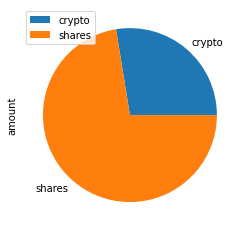

In [48]:
# Plot savings pie chart
# YOUR CODE HERE!
df_savings.plot.pie(subplots=True)

In [50]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3

# Calculate total amount of savings
# YOUR CODE HERE!
savings_total = df_savings["amount"].sum()

# Validate saving health
# YOUR CODE HERE!
if savings_total > emergency_fund:
    print("Congratulations! You have an adequate amount of capital in this fund!")
elif savings_total == emergency_fund:
    print("Congratulations on this mile stone! Now let the reminder of how difficult of a journey this was keep you from screwing up in life.")
else:
    print(f"You need {emergency_fund - savings_total} more dollars to avoid being one bad accident away from poverty in the US")

Congratulations! You have an adequate amount of capital in this fund!


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [81]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = getLastTradingDate()
end_date = getLastTradingDate() - timedelta(days=365*5)

Timestamp('2015-10-18 00:00:00')

In [87]:
# Get 5 years' worth of historical data for SPY and AGG
# YOUR CODE HERE!
df_stock_data = alpaca.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = end_date,
    limit=1000
).df

# Display sample data
df_stock_data.dropna(inplace=True)
df_stock_data

AGG                                          \
                             open      high       low    close     volume   
time                                                                        
2016-10-27 00:00:00-04:00  111.25  111.2800  111.0400  111.170  2109981.0   
2016-10-28 00:00:00-04:00  111.11  111.2600  111.0800  111.170  1569008.0   
2016-10-31 00:00:00-04:00  111.30  111.3300  111.2100  111.300  2767719.0   
2016-11-01 00:00:00-04:00  110.88  111.1342  110.8200  111.035  4524305.0   
2016-11-02 00:00:00-04:00  111.12  111.3200  111.0600  111.160  2390357.0   
...                           ...       ...       ...      ...        ...   
2020-10-12 00:00:00-04:00  117.85  117.9400  117.7700  117.930  2770157.0   
2020-10-13 00:00:00-04:00  118.01  118.0700  117.9294  118.010  3250338.0   
2020-10-14 00:00:00-04:00  118.10  118.1100  117.9850  118.040  3295967.0   
2020-10-15 00:00:00-04:00  118.15  118.1500  117.9600  117.970  4988612.0   
2020-10-16 00:00:00-04:00  117.99  118.0778  117.8800  117.880  3589312.0   

                              SPY                                         
                             open      high     low   close       volume  
time                                                                      
2016-10-27 00:00:00-04:00  214.58  214.6200  213.08  213.18   60252470.0  
2016-10-28 00:00:00-04:00  213.14  213.9300  211.71  212.52  115001746.0  
2016-10-31 00:00:00-04:00  212.93  213.1900  212.36  212.51   47327612.0  
2016-11-01 00:00:00-04:00  212.93  212.9900  209.60  211.00   95507331.0  
2016-11-02 00:00:00-04:00  210.67  211.1000  209.23  209.70   80583348.0  
...                           ...       ...     ...     ...          ...  
2020-10-12 00:00:00-04:00  349.59  354.0200  349.06  352.43   61163344.0  
2020-10-13 00:00:00-04:00  352.28  352.4651  349.09  350.15   62272512.0  
2020-10-14 00:00:00-04:00  350.75  351.9300  347.14  347.97   47281475.0  
2020-10-15 00:00:00-04:00  343.71  348.0200  343.13  347.51   50665477.0  
2020-10-16 00:00:00-04:00  348.96  350.7500  347.10  347.25   62467863.0  

[999 rows x 10 columns]

In [88]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!
MC_30year = MCSimulation(
    portfolio_data=df_stock_data,
    weights=[.4,.6],
    num_simulation=500,
    num_trading_days=252*30
)

In [89]:
# Printing the simulation input data
# YOUR CODE HERE!
MC_30year.portfolio_data.head()

AGG                                        \
                             open      high     low    close     volume   
time                                                                      
2016-10-27 00:00:00-04:00  111.25  111.2800  111.04  111.170  2109981.0   
2016-10-28 00:00:00-04:00  111.11  111.2600  111.08  111.170  1569008.0   
2016-10-31 00:00:00-04:00  111.30  111.3300  111.21  111.300  2767719.0   
2016-11-01 00:00:00-04:00  110.88  111.1342  110.82  111.035  4524305.0   
2016-11-02 00:00:00-04:00  111.12  111.3200  111.06  111.160  2390357.0   

                                           SPY                          \
                          daily_return    open    high     low   close   
time                                                                     
2016-10-27 00:00:00-04:00          NaN  214.58  214.62  213.08  213.18   
2016-10-28 00:00:00-04:00     0.000000  213.14  213.93  211.71  212.52   
2016-10-31 00:00:00-04:00     0.001169  212.93  213.19  212.36  212.51   
2016-11-01 00:00:00-04:00    -0.002381  212.93  212.99  209.60  211.00   
2016-11-02 00:00:00-04:00     0.001126  210.67  211.10  209.23  209.70   

                                                     
                                volume daily_return  
time                                                 
2016-10-27 00:00:00-04:00   60252470.0          NaN  
2016-10-28 00:00:00-04:00  115001746.0    -0.003096  
2016-10-31 00:00:00-04:00   47327612.0    -0.000047  
2016-11-01 00:00:00-04:00   95507331.0    -0.007106  
2016-11-02 00:00:00-04:00   80583348.0    -0.006161

In [90]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
# YOUR CODE HERE!
MC_30year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.990875,1.009654,1.001924,1.003528,0.999779,1.002673,1.010529,0.989414,0.987342,1.000906,...,0.995808,0.994104,1.008557,1.005482,0.997304,1.002135,1.003092,0.996544,1.008507,1.013608
2,0.987800,1.001250,0.996558,1.012261,1.004882,0.996128,1.013882,0.989126,0.990258,1.005462,...,0.987698,0.993320,1.007134,1.013953,0.996499,0.995601,0.990176,0.997935,1.005067,1.009912
3,0.992010,0.985895,0.988625,1.008882,1.017250,0.989686,1.003685,1.000936,0.993922,1.004796,...,0.983168,0.988617,0.991082,1.023355,1.000005,0.985745,0.990697,0.983742,0.996957,1.016304
4,0.998310,0.989816,0.984265,1.018268,1.011230,0.994075,1.016274,1.004267,0.991323,1.004258,...,0.984434,0.978858,1.000385,1.023912,0.995697,0.987700,0.983010,0.980578,0.996356,1.018630
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7556,3.885166,10.035216,30.210292,14.633272,14.675819,19.329044,9.966504,49.406813,6.855181,22.072963,...,15.001501,12.513754,9.242801,16.868585,15.982982,37.217701,19.443883,45.254314,10.021967,8.778313
7557,3.902492,10.039953,30.255603,14.579891,14.595493,19.288999,10.060818,48.973804,6.842519,21.864820,...,14.957151,12.526742,9.244486,17.067738,15.888244,37.012723,19.532999,45.036658,10.092139,8.687386
7558,3.882720,10.139833,30.023314,14.588674,14.856225,19.446314,10.137385,49.373140,6.872845,21.954386,...,15.116747,12.594265,9.261630,17.060437,16.111807,37.191572,19.600207,45.312968,10.144982,8.740657
7559,3.861419,10.033817,29.950267,14.622382,14.973308,19.312789,10.080675,49.224549,6.787658,22.295862,...,15.078021,12.540655,9.130000,16.946024,15.873817,37.321069,19.436882,44.815053,10.152435,8.732234


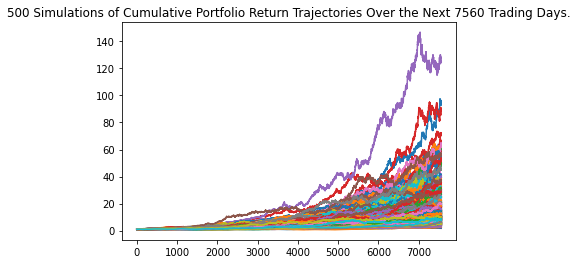

In [91]:
# Plot simulation outcomes
# YOUR CODE HERE!
plot_500 = MC_30year.plot_simulation()

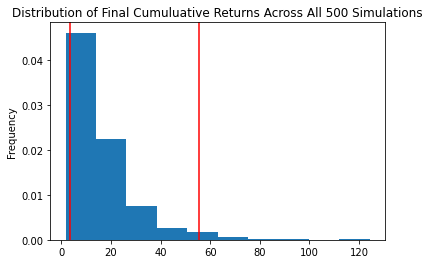

In [92]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
dist_500 = MC_30year.plot_distribution()

### Retirement Analysis

In [93]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
summary = MC_30year.summarize_cumulative_return()

# Print summary statistics
# YOUR CODE HERE!
summary

count           500.000000
mean             16.620278
std              13.640059
min               1.719285
25%               8.288216
50%              12.636685
75%              20.416142
max             124.371482
95% CI Lower      3.588756
95% CI Upper     55.670661
Name: 7560, dtype: float64

### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [94]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
# YOUR CODE HERE!
ci_lower = round(summary[8]*initial_investment,2)
ci_upper = round(summary[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $71775.12 and $1113413.22


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [95]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
# YOUR CODE HERE!
ci_lower = round(summary[8]*initial_investment,2)
ci_upper = round(summary[9]*initial_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $107662.68 and $1670119.83


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [24]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [25]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.002773,0.995921,0.995673,0.994602,1.005021,0.998532,1.001126,1.005124,0.994500,0.999171,...,1.002697,1.007377,0.999067,0.997822,0.998338,1.003092,0.997770,1.005395,0.999348,1.005300
2,1.004519,0.994920,0.995504,0.997885,0.999418,1.002665,0.998714,1.009062,0.992389,0.997706,...,1.004034,1.008911,0.999323,1.000654,0.999466,1.004265,0.994733,1.003748,0.996511,1.012382
3,1.003420,0.989709,0.994363,1.001670,1.004349,1.002377,1.001845,1.011481,0.991912,0.994580,...,1.002351,1.006664,1.002174,0.998934,1.003854,1.010202,0.996131,1.002018,0.999665,1.014892
4,0.999165,0.990064,0.986792,1.003455,1.007765,1.007514,0.997581,1.015886,0.986637,0.998216,...,1.002834,0.999865,1.000353,1.003079,1.003303,1.012221,0.997754,1.000544,1.001517,1.013704
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.266580,1.196174,1.233861,1.609848,1.173492,1.242440,1.329611,1.157732,1.354542,0.980124,...,1.193369,1.265576,1.176646,1.146853,1.214548,1.145207,1.193672,1.131104,1.003777,1.234636
1257,1.259830,1.201814,1.231141,1.621046,1.172662,1.239173,1.331916,1.157722,1.354061,0.980815,...,1.194320,1.269009,1.182694,1.146907,1.213701,1.143455,1.200143,1.131160,1.006530,1.234546
1258,1.265916,1.196261,1.226184,1.622075,1.174943,1.240829,1.335755,1.157986,1.350916,0.981539,...,1.203336,1.271746,1.178878,1.148263,1.213656,1.146064,1.197322,1.134041,1.005902,1.236184
1259,1.268268,1.202293,1.223321,1.623647,1.170809,1.248084,1.336792,1.162289,1.341674,0.977214,...,1.200892,1.273981,1.175435,1.145972,1.210717,1.146312,1.194024,1.132655,1.007751,1.242664


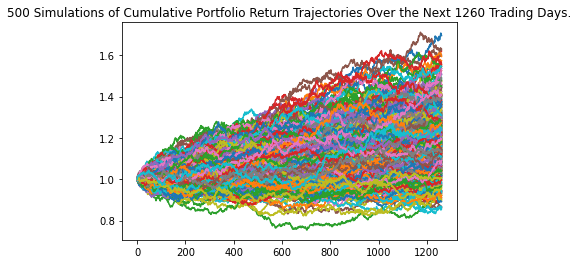

In [26]:
# Plot simulation outcomes
# YOUR CODE HERE!

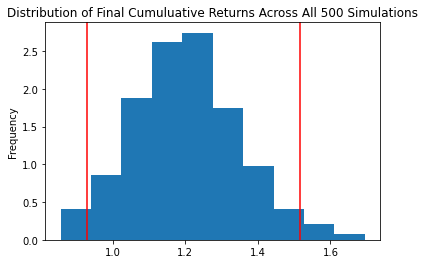

In [27]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [28]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.202273
std               0.145565
min               0.856322
25%               1.100622
50%               1.197687
75%               1.292270
max               1.695081
95% CI Lower      0.928556
95% CI Upper      1.517173
Name: 1260, dtype: float64


In [29]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $55713.36 and $91030.38


### Ten Years Retirement Option

In [30]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [31]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.997817,0.998428,1.000816,1.000202,1.002120,0.998788,1.004226,1.004250,1.001431,1.000740,...,0.995519,1.001253,1.000492,0.994026,1.006129,1.002356,1.005233,0.999769,1.002106,1.003746
2,0.994703,0.996223,1.001987,0.998816,1.002372,0.996708,1.009074,1.006986,1.006219,0.995591,...,0.991815,1.001091,1.003774,0.989341,1.007530,1.009809,1.007273,0.999666,1.006340,0.998303
3,0.994115,0.993375,0.992622,1.001069,0.999700,1.000123,1.011610,1.009254,1.012194,0.998619,...,0.992699,1.003085,1.005997,0.991536,1.004239,1.010765,1.009501,0.999652,1.011737,0.998762
4,0.999040,0.997821,0.992272,0.999767,1.000459,1.006178,1.008906,1.009897,1.014282,0.995619,...,0.997683,1.007825,1.007858,0.991188,1.009171,1.009303,1.008223,1.003270,1.014350,1.001691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.164254,1.246948,1.441080,1.685210,1.702114,1.474774,1.535126,1.288182,1.138653,1.500977,...,1.367442,1.357662,1.661583,1.348599,1.649220,1.782632,1.450872,1.701338,1.199957,1.171159
2517,2.169555,1.246315,1.436260,1.685058,1.697652,1.479128,1.536203,1.288485,1.144082,1.498097,...,1.366833,1.360457,1.672969,1.351751,1.646287,1.781356,1.459438,1.695322,1.197466,1.171882
2518,2.169089,1.243387,1.426446,1.685480,1.714264,1.479079,1.537777,1.289258,1.140795,1.496271,...,1.368088,1.357853,1.662915,1.354957,1.637911,1.781046,1.451367,1.695901,1.201111,1.172847
2519,2.170695,1.238881,1.419187,1.670521,1.720418,1.478161,1.544292,1.296500,1.137510,1.499085,...,1.370125,1.359697,1.664317,1.352170,1.633762,1.778638,1.443413,1.699061,1.191529,1.166331


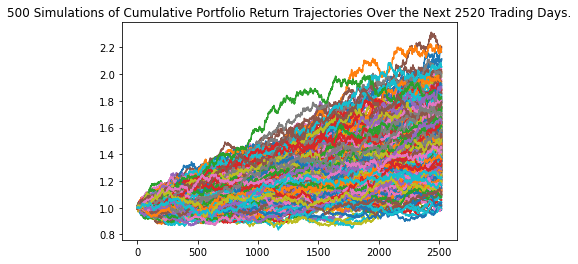

In [32]:
# Plot simulation outcomes
# YOUR CODE HERE!

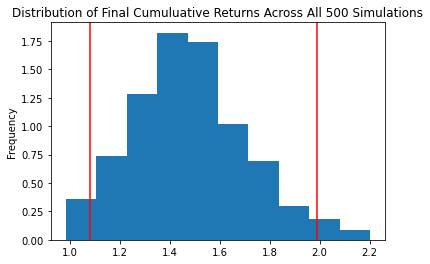

In [33]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [34]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.477364
std               0.230147
min               0.984413
25%               1.319127
50%               1.468676
75%               1.613270
max               2.202006
95% CI Lower      1.083048
95% CI Upper      1.990417
Name: 2520, dtype: float64


In [35]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $64982.9 and $119425.0
